In [5]:
%matplotlib widget
import matplotlib.pyplot as plt
import numpy as np
import cv2

In [6]:
import os 
DATA_DIR = "/home/tlips/Code/few-shot-keypoints/data/RPL-clean-pen/3mark_1arm_fullresolution"


demo_dirs = os.listdir(DATA_DIR)
# filter out directories that are not demos
demo_dirs = [d for d in demo_dirs if os.path.isdir(os.path.join(DATA_DIR, d))]
# sort by name
demo_dirs.sort()
print(f"Found {len(demo_dirs)} demonstrations")


# ðemo dir 
#  back_camera
# data.mp4

video_paths = [os.path.join(DATA_DIR, demo_dir, "right_camera", "data.mp4") for demo_dir in demo_dirs]
print(video_paths)

Found 31 demonstrations
['/home/tlips/Code/few-shot-keypoints/data/RPL-clean-pen/3mark_1arm_fullresolution/demo_0/right_camera/data.mp4', '/home/tlips/Code/few-shot-keypoints/data/RPL-clean-pen/3mark_1arm_fullresolution/demo_1/right_camera/data.mp4', '/home/tlips/Code/few-shot-keypoints/data/RPL-clean-pen/3mark_1arm_fullresolution/demo_10/right_camera/data.mp4', '/home/tlips/Code/few-shot-keypoints/data/RPL-clean-pen/3mark_1arm_fullresolution/demo_11/right_camera/data.mp4', '/home/tlips/Code/few-shot-keypoints/data/RPL-clean-pen/3mark_1arm_fullresolution/demo_12/right_camera/data.mp4', '/home/tlips/Code/few-shot-keypoints/data/RPL-clean-pen/3mark_1arm_fullresolution/demo_13/right_camera/data.mp4', '/home/tlips/Code/few-shot-keypoints/data/RPL-clean-pen/3mark_1arm_fullresolution/demo_14/right_camera/data.mp4', '/home/tlips/Code/few-shot-keypoints/data/RPL-clean-pen/3mark_1arm_fullresolution/demo_15/right_camera/data.mp4', '/home/tlips/Code/few-shot-keypoints/data/RPL-clean-pen/3mark_1ar

In [7]:
# get initial frames for each video

initial_frames = []
for video_path in video_paths:
    video = cv2.VideoCapture(video_path)
    ret, frame = video.read()
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    initial_frames.append(frame)

# save the initial frames
initial_frames = np.array(initial_frames)

In [8]:
# # instead, now get all frames of a single video
url = "/home/tlips/Code/few-shot-keypoints/data/RPL-clean-pen/3mark_1arm_fullresolution/demo_14/right_camera/data.mp4"

import imageio.v3 as iio
frames = iio.imread(url, plugin="FFMPEG")  # plugin="pyav"
# frames = frames[-1100:-800]
print(len(frames))
initial_frames = frames[::10]
print(len(initial_frames))

1065
107


In [9]:
# add the scene view from the initial frame
initial_scene_view = iio.imread(url.replace("right_camera", "back_camera"), plugin="FFMPEG")[0]

# add to initial frames
initial_frames = np.concatenate([ [initial_scene_view], initial_frames])

# save the initial frames


In [10]:


# show the initial frames
# fig ,ax = plt.subplots(len(initial_frames) // 5+1, 5, figsize=(len(initial_frames) // 5 * 3, len(initial_frames) // 5 * 3))
# for i, frame in enumerate(initial_frames):
#     ax[i // 5, i % 5].imshow(frame)
#     ax[i // 5, i % 5].axis("off")
#     ax[i // 5, i % 5].set_title(f"Demo {i}")
# plt.show()

In [11]:
color_list = ['red', 'green', 'blue', 'yellow', 'purple', 'orange', 'brown', 'pink', 'gray', 'black']

def click_callback(img_coords, ax, fig):
    def onclick(event):
        """
        This function is called when you click on the image.
        It appends the (x, y) coordinates to the 'coords' list.
        """
        # event.xdata and event.ydata are the floating point coordinates of the click
        if event.xdata is not None and event.ydata is not None:
            ix, iy = int(event.xdata), int(event.ydata)
            print(f'Clicked at x={ix}, y={iy}')
            img_coords.append((ix, iy))
            ax.scatter(ix, iy, c=color_list[len(img_coords) % len(color_list)], s=50)
            fig.canvas.draw()
    return onclick

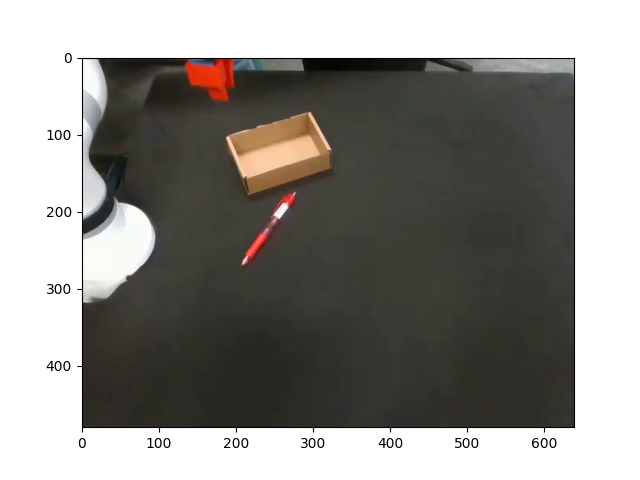

In [12]:
img_coords_1 = []

support_image_id = 0

support_img = np.array(initial_frames[support_image_id])
# drop that image from the list of initial frames, deal with edge case of having first or last image!
if support_image_id == 0:
    initial_frames = initial_frames[1:]
elif support_image_id == len(initial_frames) - 1:
    initial_frames = initial_frames[:-1]
else:
    initial_frames = initial_frames[:support_image_id] + initial_frames[support_image_id+1:]

# Create a figure and axes
fig, ax = plt.subplots()

# Display the image
ax.imshow(support_img)

# Connect the 'button_press_event' to the 'onclick' function
cid = fig.canvas.mpl_connect('button_press_event', click_callback(img_coords_1, ax, fig))

# Show the plot
plt.show()

In [ ]:
raise ValueError("first annotate the keypoints")

In [13]:
from few_shot_keypoints.featurizers import FeaturizerRegistry
from few_shot_keypoints.matcher import KeypointFeatureMatcher, KeypointListMatcher
import torch 
from torchvision import transforms

to_tensor_tf = transforms.Compose([
    transforms.ToTensor(),
])

# featurizer = FeaturizerRegistry.create("dift-sd2.1-e1")
# featurizer = FeaturizerRegistry.create("dift-sd2.1-e8")
featurizer = FeaturizerRegistry.create("dinov2-s")
# featurizer = FeaturizerRegistry.create("dinov3-l")


matchers = []
for keypoint in img_coords_1:
    matcher = KeypointFeatureMatcher(featurizer)
    matcher.add_reference_image(to_tensor_tf(support_img).unsqueeze(0), [keypoint[0], keypoint[1]])
    matchers.append(matcher)





In [14]:
# for each initial frame, search for the best keypoint match for each keypoint.

keypoint_matches = []
for img in initial_frames:
    image_matches = []
    for i in range(len(matchers)):
        matches = matchers[i].get_best_match(to_tensor_tf(img).unsqueeze(0))
        image_matches.append(matches)
    keypoint_matches.append(image_matches)

print(keypoint_matches)

[[MatchingResult(u=354, v=27, score=0.8646), MatchingResult(u=412, v=46, score=0.8488), MatchingResult(u=424, v=51, score=0.8376), MatchingResult(u=416, v=46, score=0.8385), MatchingResult(u=354, v=22, score=0.8308), MatchingResult(u=604, v=43, score=0.6054), MatchingResult(u=617, v=65, score=0.6305), MatchingResult(u=584, v=28, score=0.6417)], [MatchingResult(u=354, v=26, score=0.8681), MatchingResult(u=411, v=46, score=0.8529), MatchingResult(u=426, v=51, score=0.8385), MatchingResult(u=414, v=46, score=0.8357), MatchingResult(u=355, v=22, score=0.8321), MatchingResult(u=626, v=105, score=0.6269), MatchingResult(u=630, v=106, score=0.648), MatchingResult(u=569, v=0, score=0.6415)], [MatchingResult(u=351, v=26, score=0.8551), MatchingResult(u=410, v=47, score=0.8297), MatchingResult(u=425, v=52, score=0.8151), MatchingResult(u=424, v=50, score=0.8209), MatchingResult(u=354, v=22, score=0.8158), MatchingResult(u=618, v=75, score=0.5019), MatchingResult(u=618, v=69, score=0.5351), Match

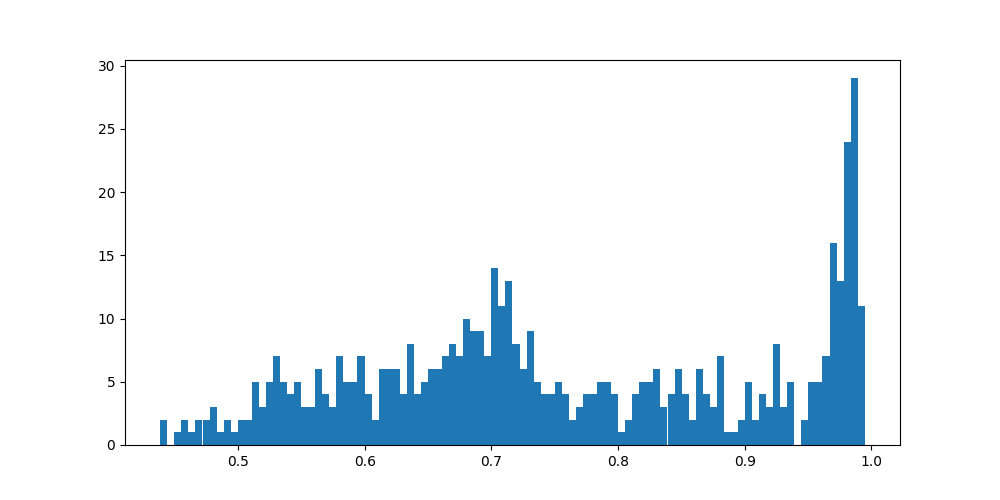

In [26]:
# distribution of the confidences

# get the confidence scores for each keypoint
confidence_scores = []
for frame_idx in range(len(initial_frames)):
    img_keypoints = keypoint_matches[frame_idx]
    for kp in img_keypoints:
        confidence_scores.append(kp.score)

# plot the distribution of the confidence scores
fig, ax = plt.subplots(figsize=(10, 5))
plt.hist(confidence_scores, bins=100)
plt.show()

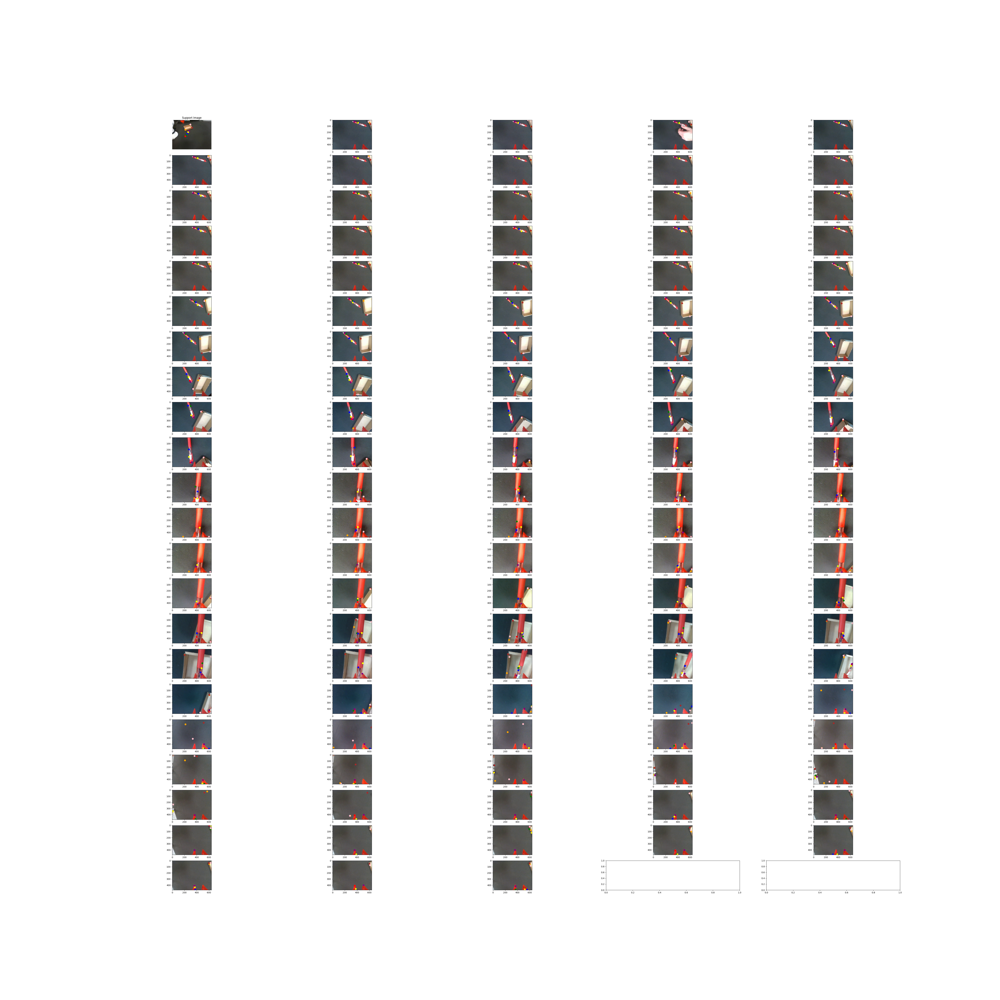

In [15]:
# visualize the keypoint matches
fig ,ax = plt.subplots(len(initial_frames) // 5+1, 5, figsize=(len(initial_frames) // 5 * 3, len(initial_frames) // 5 * 3))
ax[0,0].axis("off")
ax[0,0].set_title("Support Image")
ax[0,0].imshow(support_img)
for idx, kp in enumerate(img_coords_1):
    ax[0,0].scatter(kp[0], kp[1], c=color_list[idx % len(color_list)], s=50)
for img_idx, img in enumerate(initial_frames):
    plt_img_idx = img_idx +1 # first image is the support image
    img_keypoints = keypoint_matches[img_idx]
    ax[plt_img_idx // 5, plt_img_idx % 5].imshow(img)
    for kp_idx, kp in enumerate(img_keypoints):
        ax[plt_img_idx // 5, plt_img_idx % 5].scatter(kp.u, kp.v, c=color_list[kp_idx % len(color_list)], s=50)
        # add confidence score
        # ax[plt_img_idx // 5, plt_img_idx % 5].text(kp.u, kp.v, f"{int(100*kp.score)}", color=color_list[kp_idx % len(color_list)], fontsize=10)
plt.show()


In [28]:
# compile the frames and annotations into a video 
# get distinct colors for each keypoint
color_list = plt.cm.tab10.colors

annotated_frames = []
for frame_idx in range(len(initial_frames)):
    frame = initial_frames[frame_idx]
    annotated_frame = frame.copy()
    img_keypoints = keypoint_matches[frame_idx]
    for kp_idx, kp in enumerate(img_keypoints):
        color = color_list[kp_idx % len(color_list)]
        color = (int(color[0]*255), int(color[1]*255), int(color[2]*255))
        annotated_frame = cv2.circle(annotated_frame, (kp.u, kp.v), 5,color, -1)
        # write cofindence score on the annotated frame
        cv2.putText(annotated_frame, str(int(kp.score*100)), (kp.u, kp.v), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)
    annotated_frames.append(annotated_frame)

# save the annotated frames
iio.imwrite("videos/correspondence-episode-wrist.mp4", annotated_frames, plugin="FFMPEG")

    